# Data scrapping from the Web

In this notebook, we scrape the plot summaries and the box office revenue information from Wikipedia. 

Approximately 40% of film summaries and over 90% of box office values are missing, and these metrics are essential for our analysis. 

To fill these gaps, we use libraries like wikipedia-api and pywikibot, and in cases requiring more detail, we utilize requests and BeautifulSoup for web scraping. Our approach involves extracting summaries from the Plot/Synopsis/Summary sections and box office revenue from the InfoBox, ensuring we access the correct page by handling title variations, such as adding "(film), and handling page redirections.

This process enriches our data, specifically targeting films with incomplete summaries (replacing those under 200 words with the Wikipedia entry) and adding missing box office values.

In [17]:
!pip3 install wikipedia-api pandas pywikibot requests 

In [1]:
import pandas as pd
import json
import wikipediaapi
import pywikibot
import matplotlib.pyplot as plt
import numpy as np
import requests
from bs4 import BeautifulSoup
from concurrent.futures import ThreadPoolExecutor, as_completed
import re

In [2]:
DATA_PATH = "../../../data/movies_all_scraped.csv"
DATA_PATH2 = "../../../data/movies_to_scrape_original.csv"
DATA_PATH3 = "../../../data/movies_scraped_Xavier.csv"
pd.set_option("max_colwidth", None)

In [3]:
df_Ines = pd.read_csv(DATA_PATH)
df_movie_unscraped = pd.read_csv(DATA_PATH2)
df_Xavier = pd.read_csv(DATA_PATH3)

In [45]:
total_words_scraped = df_movie['summary'].apply(lambda x: len(str(x).split()) if pd.notna(x) else 0).sum()
total_words = df_movie_unscraped['summary'].apply(lambda x: len(str(x).split()) if pd.notna(x) else 0).sum()
print(((total_words_scraped - total_words) / total_words) * 100 if total_words != 0 else 0)

print(f"Total words across all summaries after scraping: {total_words_scraped}")
print(f"Total words across all summaries before scraping: {total_words}")

34.52787652291252
Total words across all summaries after scraping: 15594271
Total words across all summaries before scraping: 11591851


In [21]:
# Initialize a Wikipedia object using the wikipedia-api library, specifying the English language
wiki_object = wikipediaapi.Wikipedia('MovieSummaryExtractor', 'en')

# Initialize a pywikibot Site object for interacting with the English Wikipedia
site = pywikibot.Site("en", "wikipedia")

Functions to verify that the Wikipedia page is a valid film page

Function to extract a Wikipedia summary for a given movie, and update our dataset

In [22]:
import wikipediaapi
import pandas as pd
import numpy as np
from concurrent.futures import ThreadPoolExecutor
import pywikibot
from typing import List, Dict, Any
import time
# Initialize a Wikipedia object using the wikipedia-api library, specifying the English language
wiki_object = wikipediaapi.Wikipedia('MovieSummaryExtractor', 'en')


class WikiSummaryBatchProcessor:
    def __init__(self, df: pd.DataFrame, movie_name_column: str = 'Movie_name', summary_column: str = 'summary'):
        self.df = df.copy()
        self.movie_name_column = movie_name_column
        self.summary_column = summary_column
        self.batch_size = 20
        self.site = pywikibot.Site("en", "wikipedia")
        self.threshold = 200
        

    def has_film_section(self, film_name: str) -> bool:
        try:
            page_py = wiki_object.page(film_name)
            if not page_py.exists():
                return False
                
            for section_title in ["Plot", "Summary", "Synopsis"]:
                try:
                    section_plot = page_py.section_by_title(section_title)
                    if section_plot:  
                        return True
                except Exception as e:
                    print(f"Error checking section {section_title} for {film_name}: {str(e)}")
                    continue
            return False
            
        except Exception as e:
            print(f"Error in has_film_section for {film_name}: {str(e)}")
            return False

    def is_film_Wiki_page(self, title: str) -> tuple:
        try:
            page = pywikibot.Page(self.site, title)
            
            if page.exists() and page.isRedirectPage():
                page = page.getRedirectTarget()
                title = page.title()
                
            if self.has_film_section(title):
                return True, title
                
            film_title = f"{title} (film)"
            page = pywikibot.Page(self.site, film_title)
            
            if page.exists() and page.isRedirectPage():
                page = page.getRedirectTarget()
                film_title = page.title()
                
            if self.has_film_section(film_title):
                return True, film_title
                
            return False, title
            
        except Exception as e:
            print(f"Error in is_film_Wiki_page for {title}: {str(e)}")
            return False, title

    def extract_Wiki_summary(self, movie: str) -> str:
        try:
            if pd.isna(movie) or not isinstance(movie, str):
                return ''
            
            validity, title = self.is_film_Wiki_page(movie)
            if not validity or not title:
                return ''
                
            page_py = wiki_object.page(title)
            if not page_py.exists():
                return ''
                
            for section_title in ["Plot", "Summary", "Synopsis"]:
                try:
                    section_plot = page_py.section_by_title(section_title)
                    if section_plot and section_plot.text:  
                        return section_plot.text.strip()
                except Exception as e:
                    print(f"Error extracting {section_title} for {movie}: {str(e)}")
                    continue
                    
            return ''
            
        except Exception as e:
            print(f"Error processing Wikipedia page for {movie}: {str(e)}")
            return ''

    def fetch_summary_batch(self, movie_batch: pd.DataFrame) -> List[Dict[str, Any]]:
        results = []
        for _, row in movie_batch.iterrows():
            try:
                movie_title = row[self.movie_name_column]
                current_summary = row[self.summary_column]

                #First check if the summary is NaN or None
                if pd.isna(current_summary):
                    current_summary = ''
                else:
                    # Convert to string, handling potential float values
                    current_summary = str(current_summary)
                    # Remove 'nan' or 'None' strings if they exist
                    if current_summary.lower() in ['nan', 'none']:
                        current_summary = ''

                
                #if not current_summary or len(str(current_summary).split()) < self.threshold:
                if len(str(current_summary).split()) < self.threshold:
                    wiki_summary = self.extract_Wiki_summary(movie_title)
                
                    #Keep longer summary between current and wiki
                    #if current_summary and len(str(current_summary).split()) > len(str(wiki_summary).split()):
                    if len(str(current_summary).split()) > len(str(wiki_summary).split()):
                        summary = current_summary
                    else:
                        summary = wiki_summary
                else:
                    summary = current_summary
                    
                results.append({
                    'index': row.name,
                    'summary': summary,
                    'movie_name': movie_title,
                    'error': None  # Add error field
                })
                
                time.sleep(1)  # Rate limiting
                
            except Exception as e:
                error_type = type(e).__name__
                error_message = str(e)
                print(f"Error type: {error_type} in batch processing for movie '{row[self.movie_name_column]}': {error_message}")
                results.append({
                    'index': row.name,
                    'summary': '',
                    'movie_name': row[self.movie_name_column],
                    'error': f"{error_type}: {error_message}"  # Add error field
                })
                
        return results

    def process_in_batches(self, batch_size: int = None) -> pd.DataFrame:
        if batch_size:
            self.batch_size = batch_size
            
        mask = self.df[self.summary_column].apply(lambda x: not x or len(str(x).split()) < self.threshold)
        df_to_process = self.df[mask]
        
        total_movies = len(df_to_process)
        print(f"Processing {total_movies} movies in batches of {self.batch_size}...")
        
        batches = [df_to_process.iloc[i:i + self.batch_size] 
                  for i in range(0, total_movies, self.batch_size)]
        
        with ThreadPoolExecutor() as executor:
            all_results = []
            for batch_results in executor.map(self.fetch_summary_batch, batches):
                all_results.extend(batch_results)
                processed = len(all_results)
                print(f"Progress: {processed}/{total_movies} movies processed "
                      f"({(processed/total_movies*100):.1f}%)")
        
        successful_fetches = 0
        for result in all_results:
            if result['summary']:
                successful_fetches += 1
            self.df.loc[result['index'], self.summary_column] = result['summary']
            
        print(f"\nProcessing complete. Successfully fetched summaries for "
              f"{successful_fetches}/{total_movies} movies "
              f"({(successful_fetches/total_movies*100):.1f}%)")
        
        self.print_batch_summary(all_results)
        
        return self.df

    def get_processing_stats(self) -> Dict[str, Any]:
        total_rows = len(self.df)
        has_summary = self.df[self.summary_column].apply(lambda x: bool(x) and len(str(x).split()) >= self.threshold)
        successful_fetches = has_summary.sum()
        failed_fetches = total_rows - successful_fetches
        
        return {
            'total_movies': total_rows,
            'successful_fetches': successful_fetches,
            'failed_fetches': failed_fetches,
            'success_rate': (successful_fetches / total_rows * 100)
        }
    def print_batch_summary(self, results: List[Dict[str, Any]]) -> None:
        for result in results:
            print(f"\n{'='*80}")
            print(f"Movie Index: {result['index']}")
            print(f"Title: {result['movie_name']}")
            if result['error']:
                print(f"Error: {result['error']}")
            print(f"{'='*80}\n")
            print("Summary:")
            print(f"{result['summary']}\n")

In [23]:
processor = WikiSummaryBatchProcessor(df_movie)
updated_df = processor.process_in_batches(batch_size=20)
stats = processor.get_processing_stats()

Processing 44059 movies in batches of 20...
Progress: 20/44059 movies processed (0.0%)
Progress: 40/44059 movies processed (0.1%)
Progress: 60/44059 movies processed (0.1%)
Progress: 80/44059 movies processed (0.2%)
Progress: 100/44059 movies processed (0.2%)
Progress: 120/44059 movies processed (0.3%)
Progress: 140/44059 movies processed (0.3%)
Progress: 160/44059 movies processed (0.4%)
Progress: 180/44059 movies processed (0.4%)
Progress: 200/44059 movies processed (0.5%)
Progress: 220/44059 movies processed (0.5%)
Progress: 240/44059 movies processed (0.5%)
Progress: 260/44059 movies processed (0.6%)
Progress: 280/44059 movies processed (0.6%)
Progress: 300/44059 movies processed (0.7%)
Progress: 320/44059 movies processed (0.7%)
Progress: 340/44059 movies processed (0.8%)
Progress: 360/44059 movies processed (0.8%)
Progress: 380/44059 movies processed (0.9%)
Progress: 400/44059 movies processed (0.9%)
Progress: 420/44059 movies processed (1.0%)
Progress: 440/44059 movies processed

Sleeping for 5.0 seconds, 2024-11-28 17:10:38


Progress: 4580/44059 movies processed (10.4%)
Progress: 4600/44059 movies processed (10.4%)
Progress: 4620/44059 movies processed (10.5%)
Progress: 4640/44059 movies processed (10.5%)
Progress: 4660/44059 movies processed (10.6%)
Progress: 4680/44059 movies processed (10.6%)
Progress: 4700/44059 movies processed (10.7%)
Progress: 4720/44059 movies processed (10.7%)
Progress: 4740/44059 movies processed (10.8%)
Progress: 4760/44059 movies processed (10.8%)
Progress: 4780/44059 movies processed (10.8%)
Progress: 4800/44059 movies processed (10.9%)
Progress: 4820/44059 movies processed (10.9%)
Progress: 4840/44059 movies processed (11.0%)
Progress: 4860/44059 movies processed (11.0%)
Progress: 4880/44059 movies processed (11.1%)
Progress: 4900/44059 movies processed (11.1%)
Progress: 4920/44059 movies processed (11.2%)
Progress: 4940/44059 movies processed (11.2%)
Progress: 4960/44059 movies processed (11.3%)
Progress: 4980/44059 movies processed (11.3%)
Progress: 5000/44059 movies proces

Sleeping for 5.0 seconds, 2024-11-28 17:28:15
Sleeping for 9.0 seconds, 2024-11-28 17:28:24


Progress: 10300/44059 movies processed (23.4%)
Progress: 10320/44059 movies processed (23.4%)
Progress: 10340/44059 movies processed (23.5%)
Progress: 10360/44059 movies processed (23.5%)
Progress: 10380/44059 movies processed (23.6%)
Progress: 10400/44059 movies processed (23.6%)
Progress: 10420/44059 movies processed (23.7%)
Progress: 10440/44059 movies processed (23.7%)
Progress: 10460/44059 movies processed (23.7%)
Progress: 10480/44059 movies processed (23.8%)
Progress: 10500/44059 movies processed (23.8%)
Progress: 10520/44059 movies processed (23.9%)
Progress: 10540/44059 movies processed (23.9%)
Progress: 10560/44059 movies processed (24.0%)
Progress: 10580/44059 movies processed (24.0%)
Progress: 10600/44059 movies processed (24.1%)
Progress: 10620/44059 movies processed (24.1%)
Progress: 10640/44059 movies processed (24.1%)
Progress: 10660/44059 movies processed (24.2%)
Progress: 10680/44059 movies processed (24.2%)
Progress: 10700/44059 movies processed (24.3%)
Progress: 107

Sleeping for 5.0 seconds, 2024-11-28 17:43:46


Progress: 15400/44059 movies processed (35.0%)
Progress: 15420/44059 movies processed (35.0%)
Progress: 15440/44059 movies processed (35.0%)
Progress: 15460/44059 movies processed (35.1%)
Progress: 15480/44059 movies processed (35.1%)
Progress: 15500/44059 movies processed (35.2%)
Progress: 15520/44059 movies processed (35.2%)
Progress: 15540/44059 movies processed (35.3%)
Progress: 15560/44059 movies processed (35.3%)
Progress: 15580/44059 movies processed (35.4%)
Progress: 15600/44059 movies processed (35.4%)
Progress: 15620/44059 movies processed (35.5%)
Progress: 15640/44059 movies processed (35.5%)
Progress: 15660/44059 movies processed (35.5%)
Progress: 15680/44059 movies processed (35.6%)
Progress: 15700/44059 movies processed (35.6%)
Progress: 15720/44059 movies processed (35.7%)
Progress: 15740/44059 movies processed (35.7%)
Progress: 15760/44059 movies processed (35.8%)
Progress: 15780/44059 movies processed (35.8%)
Progress: 15800/44059 movies processed (35.9%)
Progress: 158

ERROR: An error occurred for uri https://en.wikipedia.org/w/api.php?action=query&prop=info&titles=Police+Assassins&redirects=&meta=userinfo&uiprop=blockinfo%7Chasmsg&maxlag=5&format=json
ERROR: Traceback (most recent call last):
  File "C:\Users\inesa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\pywikibot\data\api\_requests.py", line 689, in _http_request
    response = http.request(self.site, uri=uri,
               ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\inesa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\pywikibot\comms\http.py", line 283, in request
    r = fetch(baseuri, headers=headers, **kwargs)
        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\inesa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\pywikibot\comms\http.py", 

Error checking section Plot for The Family Honor: ('Connection aborted.', RemoteDisconnected('Remote end closed connection without response'))Error checking section Plot for Luke's Preparedness Preparations: ('Connection aborted.', RemoteDisconnected('Remote end closed connection without response'))

Progress: 16980/44059 movies processed (38.5%)
Progress: 17000/44059 movies processed (38.6%)
Progress: 17020/44059 movies processed (38.6%)
Progress: 17040/44059 movies processed (38.7%)
Progress: 17060/44059 movies processed (38.7%)
Progress: 17080/44059 movies processed (38.8%)
Progress: 17100/44059 movies processed (38.8%)
Progress: 17120/44059 movies processed (38.9%)
Progress: 17140/44059 movies processed (38.9%)
Progress: 17160/44059 movies processed (38.9%)
Progress: 17180/44059 movies processed (39.0%)
Progress: 17200/44059 movies processed (39.0%)
Progress: 17220/44059 movies processed (39.1%)
Progress: 17240/44059 movies processed (39.1%)
Progress: 17260/44059 movies processed (

Sleeping for 5.0 seconds, 2024-11-28 18:05:55
Sleeping for 3.0 seconds, 2024-11-28 18:06:00


Progress: 22640/44059 movies processed (51.4%)
Progress: 22660/44059 movies processed (51.4%)
Progress: 22680/44059 movies processed (51.5%)
Progress: 22700/44059 movies processed (51.5%)
Progress: 22720/44059 movies processed (51.6%)
Progress: 22740/44059 movies processed (51.6%)
Progress: 22760/44059 movies processed (51.7%)
Progress: 22780/44059 movies processed (51.7%)
Progress: 22800/44059 movies processed (51.7%)
Progress: 22820/44059 movies processed (51.8%)
Progress: 22840/44059 movies processed (51.8%)
Progress: 22860/44059 movies processed (51.9%)
Progress: 22880/44059 movies processed (51.9%)
Progress: 22900/44059 movies processed (52.0%)
Progress: 22920/44059 movies processed (52.0%)
Progress: 22940/44059 movies processed (52.1%)
Progress: 22960/44059 movies processed (52.1%)
Progress: 22980/44059 movies processed (52.2%)
Progress: 23000/44059 movies processed (52.2%)
Progress: 23020/44059 movies processed (52.2%)
Progress: 23040/44059 movies processed (52.3%)
Progress: 230

Sleeping for 5.0 seconds, 2024-11-28 18:33:51


Progress: 31800/44059 movies processed (72.2%)
Progress: 31820/44059 movies processed (72.2%)
Progress: 31840/44059 movies processed (72.3%)
Progress: 31860/44059 movies processed (72.3%)
Progress: 31880/44059 movies processed (72.4%)
Progress: 31900/44059 movies processed (72.4%)
Progress: 31920/44059 movies processed (72.4%)
Progress: 31940/44059 movies processed (72.5%)
Progress: 31960/44059 movies processed (72.5%)
Progress: 31980/44059 movies processed (72.6%)
Progress: 32000/44059 movies processed (72.6%)
Progress: 32020/44059 movies processed (72.7%)
Progress: 32040/44059 movies processed (72.7%)
Progress: 32060/44059 movies processed (72.8%)
Progress: 32080/44059 movies processed (72.8%)
Progress: 32100/44059 movies processed (72.9%)
Progress: 32120/44059 movies processed (72.9%)
Progress: 32140/44059 movies processed (72.9%)
Progress: 32160/44059 movies processed (73.0%)
Progress: 32180/44059 movies processed (73.0%)
Progress: 32200/44059 movies processed (73.1%)
Progress: 322

Sleeping for 5.0 seconds, 2024-11-28 18:38:12


Progress: 33180/44059 movies processed (75.3%)
Progress: 33200/44059 movies processed (75.4%)
Progress: 33220/44059 movies processed (75.4%)
Progress: 33240/44059 movies processed (75.4%)
Progress: 33260/44059 movies processed (75.5%)
Progress: 33280/44059 movies processed (75.5%)
Progress: 33300/44059 movies processed (75.6%)
Progress: 33320/44059 movies processed (75.6%)
Progress: 33340/44059 movies processed (75.7%)
Progress: 33360/44059 movies processed (75.7%)
Progress: 33380/44059 movies processed (75.8%)
Progress: 33400/44059 movies processed (75.8%)
Progress: 33420/44059 movies processed (75.9%)
Progress: 33440/44059 movies processed (75.9%)
Progress: 33460/44059 movies processed (75.9%)
Progress: 33480/44059 movies processed (76.0%)
Progress: 33500/44059 movies processed (76.0%)
Progress: 33520/44059 movies processed (76.1%)
Progress: 33540/44059 movies processed (76.1%)
Progress: 33560/44059 movies processed (76.2%)
Progress: 33580/44059 movies processed (76.2%)
Progress: 336

Sleeping for 5.0 seconds, 2024-11-28 18:50:57


Progress: 37280/44059 movies processed (84.6%)
Progress: 37300/44059 movies processed (84.7%)
Progress: 37320/44059 movies processed (84.7%)
Progress: 37340/44059 movies processed (84.7%)
Progress: 37360/44059 movies processed (84.8%)
Progress: 37380/44059 movies processed (84.8%)
Progress: 37400/44059 movies processed (84.9%)
Progress: 37420/44059 movies processed (84.9%)
Progress: 37440/44059 movies processed (85.0%)
Progress: 37460/44059 movies processed (85.0%)
Progress: 37480/44059 movies processed (85.1%)
Progress: 37500/44059 movies processed (85.1%)
Progress: 37520/44059 movies processed (85.2%)
Progress: 37540/44059 movies processed (85.2%)
Progress: 37560/44059 movies processed (85.2%)
Progress: 37580/44059 movies processed (85.3%)
Progress: 37600/44059 movies processed (85.3%)
Progress: 37620/44059 movies processed (85.4%)
Progress: 37640/44059 movies processed (85.4%)
Progress: 37660/44059 movies processed (85.5%)
Progress: 37680/44059 movies processed (85.5%)
Progress: 377

2min10s for 2000 sample size with 200 word threshold and batch_size = 20 (589 movies to process --> increase in percentage of total words of 9,88%)
Successfully fetched summaries for 390/589 movies (66.2%) ---> output type of error, reduce batches, increase sleep time, change agent?? just wikipedia pages have really different names (other things append) or have no plot section at all

In [24]:
df_movie = updated_df

In [25]:
df_movie.to_csv(DATA_PATH, index=False)

In [26]:
def get_total_word_count(df: pd.DataFrame) -> int:
   # Sum up word counts from all summaries, handling NaN/None values
   total_words = df['summary'].apply(lambda x: len(str(x).split()) if pd.notna(x) else 0).sum()
   return total_words
def calculate_percentage_increase(initial: float, final: float) -> float:
   return ((final - initial) / initial) * 100 if initial != 0 else 0

In [27]:
word_count_scraped = get_total_word_count(df_movie)
print(f"Total words across all summaries after scraping: {word_count_scraped}")
word_count_unscraped = get_total_word_count(df_movie_unscraped)
print(f"Total words across all summaries before scraping: {word_count_unscraped}")
percentage_increase = calculate_percentage_increase(word_count_unscraped,word_count_scraped)
print(percentage_increase)

Total words across all summaries after scraping: 15594271
Total words across all summaries before scraping: 11591851
34.52787652291252


Text(0.5, 1.0, 'Distribution of the length of the summary before scraping')

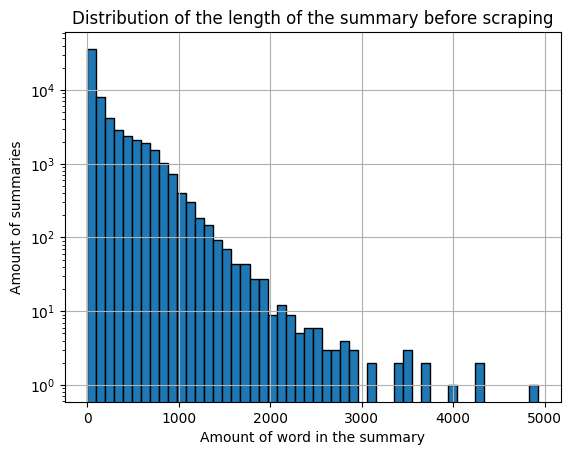

In [28]:
# Plot the distribution of the length of the summaries before scraping
df_plot_length_unscraped = df_movie_unscraped['summary'].apply(lambda x: len(str(x).split()) if pd.notna(x) else 0)
df_plot_length_unscraped.hist(bins=50, edgecolor='black')
plt.yscale('log')
plt.xlabel('Amount of word in the summary')
plt.ylabel('Amount of summaries')
plt.title('Distribution of the length of the summary before scraping')

Text(0.5, 1.0, 'Distribution of the length of the summary after scrapping')

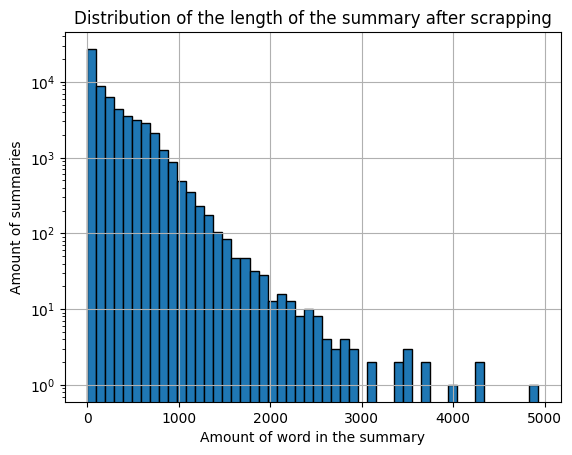

In [29]:
# Plot the distribution of the length of the summaries after scraping
df_plot_length_scraped = df_movie['summary'].apply( lambda x: len(str(x).split()) if pd.notna(x) else 0)
df_plot_length_scraped.hist(bins=50, edgecolor='black')
plt.yscale('log')
plt.xlabel('Amount of word in the summary')
plt.ylabel('Amount of summaries')
plt.title('Distribution of the length of the summary after scrapping')

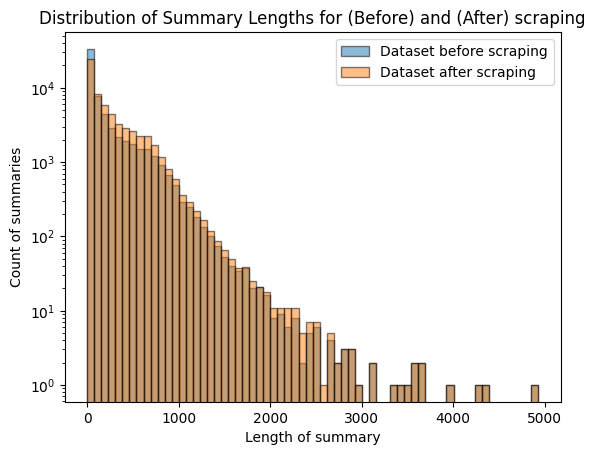

In [30]:
# Calculate the common range for both datasets, before and after scraping
min_val = min(df_plot_length_unscraped.min(), df_plot_length_scraped.min())  
max_val = max(df_plot_length_unscraped.max(), df_plot_length_scraped.max()) 

# Define the bin edges based on the common range 
bin_edges = np.linspace(min_val, max_val, 65)  

# Plot histograms 
plt.hist(df_plot_length_unscraped, bins=bin_edges, edgecolor='black', alpha=0.5, label='Dataset before scraping')
plt.hist(df_plot_length_scraped, bins=bin_edges, edgecolor='black', alpha=0.5, label='Dataset after scraping')

# Set a logarithmic scale for the y-axis
plt.yscale('log')

# Add labels, title, and legend
plt.xlabel('Length of summary')
plt.ylabel('Count of summaries')
plt.title('Distribution of Summary Lengths for (Before) and (After) scraping')
plt.legend()

# Show the plot
plt.show()

When comparing the two distributions of summary lengths, we observe that after scraping, there is an increase in the number of longer summaries, subsequently accompanied by a decrease in the number of shorter ones. This shift is further balanced by the fact that some previously missing summaries (NaN values) have now been populated.

In [31]:
# Calculate word counts for unscraped datasets
df_movie_unscraped.loc[:, 'word_count'] = df_movie_unscraped['summary'].apply(
    lambda x: len(str(x).split()) if pd.notna(x) else 0)

# Calculate word counts for scraped dataset
df_movie.loc[:, 'word_count'] = df_movie['summary'].apply(
    lambda x: len(str(x).split()) if pd.notna(x) else 0)

# Calculate the differences in word counts 
word_count_diff = df_movie['word_count'] - df_movie_unscraped['word_count']

# Calculate the average and standard deviation of the differences
average_difference = word_count_diff.mean()
std_dev_difference = word_count_diff.std()

# Print the results
print(f"Average difference in word count: {average_difference:.2f}")
print(f"Standard deviation of the difference: {std_dev_difference:.2f}")


# Filter rows with 200 words or less
filtered_rows = df_movie_unscraped[df_movie_unscraped['word_count'] <= 200]

# Calculate percentage
percentage = (len(filtered_rows) / len(df_movie_unscraped)) * 100

print(f"Percentage of rows with summaries of 200 words or less: {percentage:.2f}%")

Average difference in word count: 64.55
Standard deviation of the difference: 170.48
Percentage of rows with summaries of 200 words or less: 71.14%


In [32]:
# Count how many rows in scraped dataset are shorter than the corresponding rows in unscraped dataset
longer_in_scraped_dataset = (word_count_diff > 0).sum()

max_longer = word_count_diff.max()
print(f"Max diff in word count: {max_longer:.2f}")

total_rows = len(word_count_diff)

percentage_longer_in_df2 = (longer_in_scraped_dataset / total_rows) * 100
print(f"Percentage of rows where scraped dataset has more words than unscraped dataset: {percentage_longer_in_df2:.2f}%")

Max diff in word count: 2657.00
Percentage of rows where scraped dataset has more words than unscraped dataset: 28.91%
